## **Loading the required libraries**

In [1]:
!pip install catboost

In [2]:
import pandas as pd
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import roc_auc_score, accuracy_score
from sklearn.model_selection import train_test_split

from sklearn import tree
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from catboost import CatBoostClassifier


from IPython.display import SVG
from graphviz import Source
from IPython.display import display
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
from IPython.display import HTML
style = "<style>svg{width:50% !important;height:50% !important;}</style>"
HTML(style)

In [4]:
def result_pred(pred, resY):
    print(f'roc_auc_score: {roc_auc_score(resY, pred)}',
         f'accuracy:{accuracy_score(resY, pred)}')


def result_value(pred, resY):
    return [roc_auc_score(resY, pred), accuracy_score(resY, pred)]


def result_table(args, resY, subcol=None, valueSubCol=None):
    if subcol and valueSubCol:
        dt = {subcol: valueSubCol,
            'roc_auc_score': [],
             'accuracy': []}
    else:
        dt = {'roc_auc_score': [],
             'accuracy': []}
    preds = args
    for pred in preds:
        tmp = result_value(pred, resY)
        dt['roc_auc_score'].append(tmp[0])
        dt['accuracy'].append(tmp[-1])
    return dt

## **Loading the dataset**

In [5]:
data = pd.read_csv('/kaggle/input/titanic/train.csv')
data.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S


## **Checking for empty values**

In [6]:
data.isnull().sum()

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64

In [7]:
data.columns[data.isna().any()]

Index(['Age', 'Cabin', 'Embarked'], dtype='object')

### **There are empty values, you need to get rid of them**

In [8]:
data.dtypes

PassengerId      int64
Survived         int64
Pclass           int64
Name            object
Sex             object
Age            float64
SibSp            int64
Parch            int64
Ticket          object
Fare           float64
Cabin           object
Embarked        object
dtype: object

## **Get rid of empty values and categorical features**

### **Age**

In [9]:
data['Age'] = data['Age'].fillna(data['Age'].median())

### **Embarked**

In [10]:
data['Embarked'].value_counts()

S    644
C    168
Q     77
Name: Embarked, dtype: int64

In [11]:
data['Embarked'] = data['Embarked'].fillna('S')

### **We go further, we translate categorical into numerical**

In [12]:
data.dtypes

PassengerId      int64
Survived         int64
Pclass           int64
Name            object
Sex             object
Age            float64
SibSp            int64
Parch            int64
Ticket          object
Fare           float64
Cabin           object
Embarked        object
dtype: object

### **Sex**

In [13]:
data['Sex'] = data['Sex'].astype('category')
data['Sex'] = data['Sex'].cat.codes

### **Embarked**

In [14]:
data = pd.get_dummies(data, columns=['Embarked'])

In [15]:
data = data.drop(
    columns=['PassengerId', 'Name', 'Ticket', 'Cabin']
)

In [16]:
data

,Survived,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked_C,Embarked_Q,Embarked_S
0,0,3,1,22.0,1,0,7.2500,0,0,1
1,1,1,0,38.0,1,0,71.2833,1,0,0
2,1,3,0,26.0,0,0,7.9250,0,0,1
3,1,1,0,35.0,1,0,53.1000,0,0,1
4,0,3,1,35.0,0,0,8.0500,0,0,1
...,...,...,...,...,...,...,...,...,...,...
886,0,2,1,27.0,0,0,13.0000,0,0,1
887,1,1,0,19.0,0,0,30.0000,0,0,1
888,0,3,0,28.0,1,2,23.4500,0,0,1
889,1,1,1,26.0,0,0,30.0000,1,0,0


<Axes: >

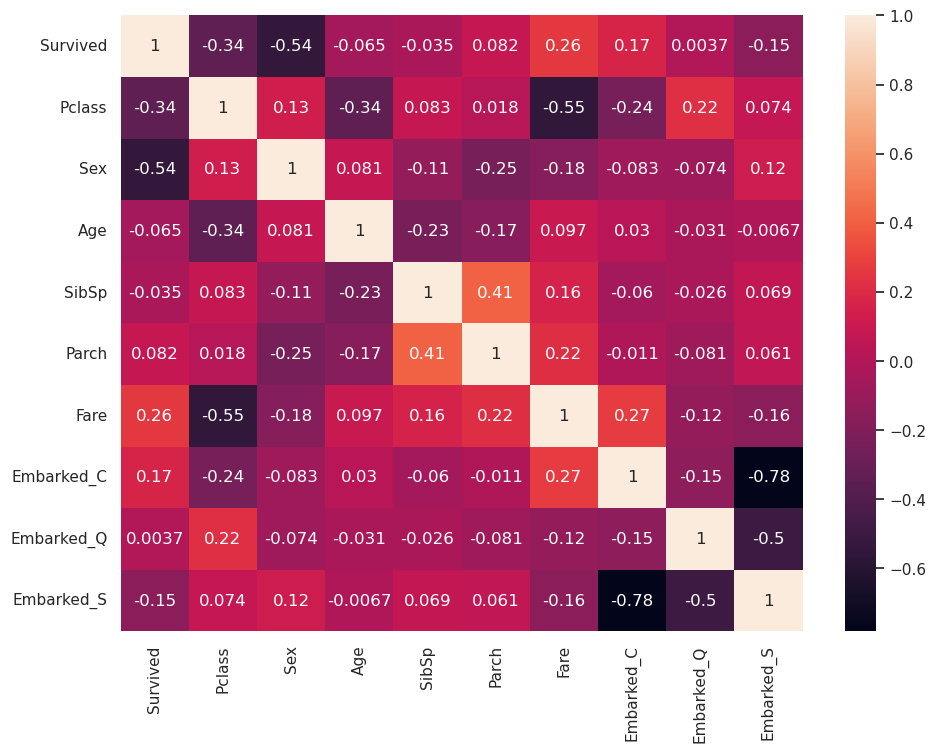

In [17]:
corr_matrix = data.corr()

sns.set(rc={'figure.figsize': (11, 8)})

sns.heatmap(corr_matrix, annot=True)

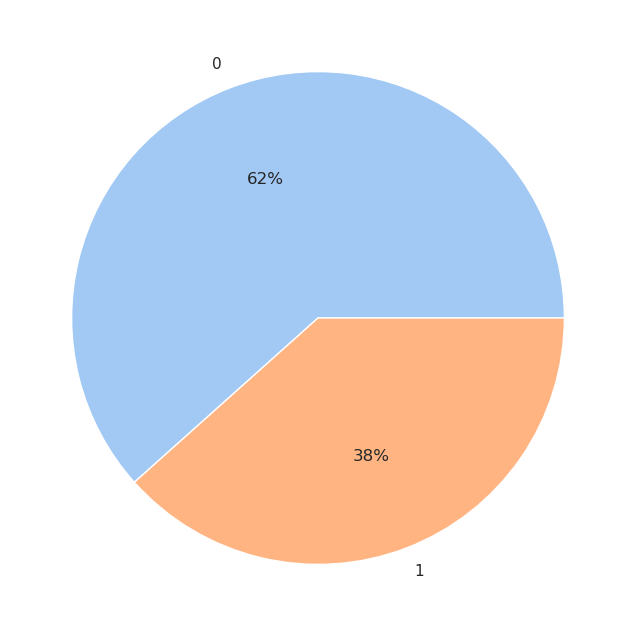

In [18]:
colors = sns.color_palette('pastel')[0:5]
labels = sorted(data['Survived'].unique())
dt = np.array([len(data[data['Survived'] == i])for i in labels])
plt.pie(dt, labels=labels, colors = colors, autopct='%.0f%%')
plt.show()

## **Divide into test and validation samples**

In [19]:
X = data.drop(columns=['Survived'])
Y = data['Survived']

In [20]:
X_train, X_valid, Y_train, Y_valid = train_test_split(X, Y, test_size=0.15, random_state=42)

## **Now let's choose a model**

In [21]:
knn = KNeighborsClassifier()
knn.fit(X_train, Y_train)
pred_knn = knn.predict(X_valid)

In [22]:
clr = LogisticRegression()
clr.fit(X_train, Y_train)
pred_clr = clr.predict(X_valid)

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [23]:
dt_clf = tree.DecisionTreeClassifier()
dt_clf.fit(X_train, Y_train)
pred_dt_clf = dt_clf.predict(X_valid)

In [24]:
rf_clf = RandomForestClassifier()
rf_clf.fit(X_train, Y_train)
pred_rf_clf = rf_clf.predict(X_valid)

In [25]:
catBoost = CatBoostClassifier(verbose=500)
catBoost.fit(X_train, Y_train)
pred_catBoost = catBoost.predict(X_valid)

Learning rate set to 0.009148
0:	learn: 0.6866799	total: 54.2ms	remaining: 54.2s
500:	learn: 0.3350515	total: 559ms	remaining: 557ms
999:	learn: 0.2792609	total: 1.12s	remaining: 0us


In [26]:
gbc = GradientBoostingClassifier()
gbc.fit(X_train, Y_train)
pred_gbc = gbc.predict(X_valid)

In [27]:
comparison_table = pd.DataFrame(result_table([pred_knn, pred_clr, pred_dt_clf, pred_rf_clf, pred_catBoost, pred_gbc],
                                              Y_valid,
                                              subcol='models',
                                              valueSubCol=['knn', 'LogisticRegression', 'DecisionTreeClassifier',
                                                          'RandomForestClassifier', 'CatBoostClassifier', 'GradientBoostingClassifier']))
comparison_table

,models,roc_auc_score,accuracy
0,knn,0.735577,0.753731
1,LogisticRegression,0.789148,0.798507
2,DecisionTreeClassifier,0.774954,0.776119
3,RandomForestClassifier,0.807005,0.813433
4,CatBoostClassifier,0.836538,0.850746
5,GradientBoostingClassifier,0.828755,0.835821


### **4 models showed good results: LogisticRegression, RandomForestClassifier, CatBoostClassifier, GradientBoostingClassifier. For them, we select the parameters and choose the best of them.**

## **Parameter enumeration**

In [28]:
clf = LogisticRegression()

param_grid = {
    'dual': [True, False],
    'C': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 100, 0.1, 0.3, 0.5, 0.01, 0.05, 0.001, 0.005],
    'fit_intercept': [True, False],
    'penalty': ['l1', 'l2'],
    'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'warm_start': [True, False],
    'multi_class': ['auto', 'ovr', 'multinomial']
}

search_LR = GridSearchCV(clf, param_grid, n_jobs=-1, cv=5, refit=True, scoring='accuracy', verbose=1000)

search_LR.fit(X_train, Y_train)

Fitting 5 folds for each of 5184 candidates, totalling 25920 fits


/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


[CV 2/5; 1/5184] START C=1, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 2/5; 1/5184] END C=1, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 3/5184] START C=1, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 3/5184] END C=1, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 3/5184] START C=1, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 5/5; 3/5184] END C=1, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 4/5184] START C=1, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 5/5; 4/5184] END C=1, dual=True, fit_intercept=True, mu

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 1/5; 56/5184] START C=1, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 1/5; 56/5184] END C=1, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 56/5184] START C=1, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 56/5184] END C=1, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 56/5184] START C=1, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 56/5184] END C=1, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 56/5184] START C=1, dual=True, fit_intercept=True, multi_class=multinomial, 

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

e, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 85/5184] END C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 85/5184] START C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 5/5; 85/5184] END C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 86/5184] START C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 86/5184] END C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 86/5184] START C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 2/5; 86/5184] END C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfg

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html

[CV 3/5; 92/5184] END C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 92/5184] START C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 92/5184] END C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 92/5184] START C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 5/5; 92/5184] END C=1, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 144/5184] START C=1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False
[CV 2/5; 144/5184] END C=1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=Fal

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 5/5; 115/5184] END C=1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 116/5184] START C=1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 1/5; 116/5184] END C=1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 116/5184] START C=1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 116/5184] END C=1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 116/5184] START C=1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 116/5184] END C=1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_star

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 4/5; 176/5184] END C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 176/5184] START C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 5/5; 176/5184] END C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 177/5184] START C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 1/5; 177/5184] END C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 177/5184] START C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 2/5; 177/5184] END C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 177

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/module

[CV 3/5; 160/5184] END C=1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.821 total time=   0.0s
[CV 4/5; 160/5184] START C=1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 160/5184] END C=1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 160/5184] START C=1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 160/5184] END C=1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.795 total time=   0.0s
[CV 1/5; 161/5184] START C=1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 161/5184] END C=1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;, score=0.836 total ti

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 3/5; 191/5184] END C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True;, score=0.689 total time=   0.0s
[CV 4/5; 191/5184] START C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True
[CV 4/5; 191/5184] END C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 5/5; 191/5184] START C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True
[CV 5/5; 191/5184] END C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 1/5; 192/5184] START C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 1/5; 192/5184] END C=1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 192/5184] START C=1, dual

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 5/5; 204/5184] START C=1, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV 5/5; 204/5184] END C=1, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False;, score=0.662 total time=   0.0s
[CV 1/5; 205/5184] START C=1, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 1/5; 205/5184] END C=1, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.836 total time=   0.1s
[CV 2/5; 205/5184] START C=1, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 2/5; 205/5184] END C=1, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.783 total time=   0.1s
[CV 3/5; 205/5184] START C=1, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 236/5184] START C=1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 1/5; 236/5184] END C=1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.816 total time=   0.0s
[CV 2/5; 236/5184] START C=1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 236/5184] END C=1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.776 total time=   0.0s
[CV 3/5; 236/5184] START C=1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 236/5184] END C=1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.828 total time=   0.0s
[CV 4/5; 236/5184] START C=1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=new

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 254/5184] END C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 254/5184] START C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 5/5; 254/5184] END C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.755 total time=   0.0s
[CV 1/5; 255/5184] START C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=True
[CV 1/5; 255/5184] END C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=True;, score=0.816 total time=   0.0s
[CV 2/5; 255/5184] START C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=True
[CV 2/5; 255/5184] END C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=True;, score=0.776 total time=   0.0s
[CV

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the co

[CV 5/5; 259/5184] END C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.781 total time=   0.0s
[CV 1/5; 260/5184] START C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 1/5; 260/5184] END C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.816 total time=   0.0s
[CV 2/5; 260/5184] START C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 260/5184] END C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.776 total time=   0.0s
[CV 3/5; 260/5184] START C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 260/5184] END C=1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-choles

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocess

e;, score=nan total time=   0.0s
[CV 4/5; 321/5184] START C=2, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 4/5; 321/5184] END C=2, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 321/5184] START C=2, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 5/5; 321/5184] END C=2, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 322/5184] START C=2, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 1/5; 322/5184] END C=2, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 322/5184] START C=2, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 2/5; 322/5184] END C=2, dual=True, fit_intercep

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

=2, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 347/5184] START C=2, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 2/5; 347/5184] END C=2, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 347/5184] START C=2, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 3/5; 347/5184] END C=2, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 347/5184] START C=2, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 347/5184] END C=2, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 347/5184] 

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 3/5; 370/5184] START C=2, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 370/5184] END C=2, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 370/5184] START C=2, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 4/5; 370/5184] END C=2, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 370/5184] START C=2, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 370/5184] END C=2, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 371/5184] START C=2, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 1/5; 371/5184] END C=2, dual=True, fit_intercept=False, multi_

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5; 415/5184] START C=2, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 3/5; 415/5184] END C=2, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 415/5184] START C=2, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 4/5; 415/5184] END C=2, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 415/5184] START C=2, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 5/5; 415/5184] END C=2, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 416/5184] START C=2, dual=True, fit_intercept=False, multi_class=multi

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 439/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 439/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 2/5; 439/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 439/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 3/5; 439/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 439/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 4/5; 439/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_st

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 

[CV 1/5; 284/5184] END C=1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 284/5184] START C=1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 284/5184] END C=1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 284/5184] START C=1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 284/5184] END C=1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 284/5184] START C=1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 284/5184] END C=1, dual=False, fit_intercept=False, multi_

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 4/5; 481/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 481/5184] START C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True
[CV 5/5; 481/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 482/5184] START C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False
[CV 1/5; 482/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 482/5184] START C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False
[CV 2/5; 482/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 5/5; 444/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 1/5; 445/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 1/5; 445/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=0.829 total time=   0.0s
[CV 2/5; 445/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 2/5; 445/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=0.783 total time=   0.0s
[CV 3/5; 445/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 3/5; 445/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 445/5184] STA

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 463/5184] START C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 5/5; 463/5184] END C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 464/5184] START C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 1/5; 464/5184] END C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 502/5184] START C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 4/5; 502/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.675 total time=   0.0s
[CV 5/5; 502/5184] START C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 5/5; 474/5184] END C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=0.788 total time=   0.0s
[CV 1/5; 475/5184] START C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 1/5; 475/5184] END C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 475/5184] START C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 2/5; 475/5184] END C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.783 total time=   0.0s
[CV 3/5; 475/5184] START C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 475/5184] END C=2, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=Tr

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

[CV 4/5; 450/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False;, score=0.755 total time=   0.1s
[CV 5/5; 450/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False
[CV 5/5; 450/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False;, score=0.788 total time=   0.1s
[CV 1/5; 451/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 1/5; 451/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 451/5184] START C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 2/5; 451/5184] END C=2, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5; 492/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False;, score=0.669 total time=   0.1s
[CV 5/5; 492/5184] START C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV 5/5; 492/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False;, score=0.662 total time=   0.0s
[CV 1/5; 493/5184] START C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 1/5; 493/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.842 total time=   0.1s
[CV 2/5; 493/5184] START C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 2/5; 493/5184] END C=2, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, scor

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 520/5184] END C=2, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.821 total time=   0.0s
[CV 4/5; 520/5184] START C=2, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 520/5184] END C=2, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.762 total time=   0.0s
[CV 5/5; 520/5184] START C=2, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 520/5184] END C=2, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.788 total time=   0.0s
[CV 1/5; 521/5184] START C=2, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 521/5184] END C=2, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;, score=0.829 t

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 544/5184] END C=2, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.788 total time=   0.0s
[CV 1/5; 545/5184] START C=2, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 545/5184] END C=2, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.829 total time=   0.0s
[CV 2/5; 545/5184] START C=2, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 2/5; 545/5184] END C=2, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.776 total time=   0.0s
[CV 3/5; 545/5184] START C=2, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 3/5; 545/5184] END C=2, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.821 total time= 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 2/5; 586/5184] END C=3, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 586/5184] START C=3, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 586/5184] END C=3, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 586/5184] START C=3, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 4/5; 586/5184] END C=3, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 586/5184] START C=3, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 586/5184] END C=3, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 587/5184] START C=3, dual=True, fit

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.

[CV 2/5; 618/5184] END C=3, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 618/5184] START C=3, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/5; 618/5184] END C=3, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 618/5184] START C=3, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 4/5; 618/5184] END C=3, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 618/5184] START C=3, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 5/5; 618/5184] END C=3, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 5/5; 629/5184] END C=3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 630/5184] START C=3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False
[CV 1/5; 630/5184] END C=3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 630/5184] START C=3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False
[CV 2/5; 630/5184] END C=3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 630/5184] START C=3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False
[CV 3/5; 630/5184] END C=3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, wa

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iteration

[CV 3/5; 661/5184] START C=3, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 3/5; 661/5184] END C=3, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 661/5184] START C=3, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 661/5184] END C=3, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 661/5184] START C=3, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 5/5; 661/5184] END C=3, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 662/5184] START C=3, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 662/5184] END C=3, dual=True, fit_intercept=False

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 2/5; 715/5184] END C=3, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 715/5184] START C=3, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 715/5184] END C=3, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 715/5184] START C=3, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 4/5; 715/5184] END C=3, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 715/5184] START C=3, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 5/5; 715/5184] END C=3, dual=True, fit_intercept=False, multi_class=multino

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 570/5184] END C=2, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.836 total time=   0.1s
[CV 2/5; 570/5184] START C=2, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 2/5; 570/5184] END C=2, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.783 total time=   0.1s
[CV 3/5; 570/5184] START C=2, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/5; 570/5184] END C=2, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.821 total time=   0.0s
[CV 4/5; 570/5184] START C=2, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 4/5; 570/5184] END C=2, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/module

[CV 3/5; 730/5184] END C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 730/5184] START C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 4/5; 730/5184] END C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 730/5184] START C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 730/5184] END C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 731/5184] START C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 1/5; 731/5184] END C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.691 total time=   0.0s
[CV 2/5; 731/5184] START C=3, dual=

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 724/5184] START C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 1/5; 724/5184] END C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.836 total time=   0.0s
[CV 2/5; 724/5184] START C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 2/5; 724/5184] END C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.783 total time=   0.0s
[CV 3/5; 724/5184] START C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 3/5; 724/5184] END C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.828 total time=   0.0s
[CV 4/5; 724/5184] START C=3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 4/5; 724/5184]

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 752/5184] START C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 752/5184] END C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 752/5184] START C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 752/5184] END C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 752/5184] START C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 5/5; 752/5184] END C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 753/5184] START C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[C

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 1/5; 768/5184] START C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 1/5; 768/5184] END C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 768/5184] START C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 2/5; 768/5184] END C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.724 total time=   0.0s
[CV 3/5; 768/5184] START C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 3/5; 768/5184] END C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.689 total time=   0.0s
[CV 4/5; 768/5184] START C=3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 768/5184] END C=3, dual=False, fit_intercept=True, 

heck_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reache

[CV 4/5; 778/5184] END C=3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 778/5184] START C=3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 778/5184] END C=3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 779/5184] START C=3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 1/5; 779/5184] END C=3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=0.691 total time=   0.1s
[CV 2/5; 779/5184] START C=3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 2/5; 779/5184] END C=3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=0.711 tot

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 

[CV 1/5; 813/5184] END C=3, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True;, score=0.697 total time=   0.0s
[CV 2/5; 813/5184] START C=3, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True
[CV 2/5; 813/5184] END C=3, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True;, score=0.711 total time=   0.0s
[CV 3/5; 813/5184] START C=3, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True
[CV 3/5; 813/5184] END C=3, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True;, score=0.682 total time=   0.0s
[CV 4/5; 813/5184] START C=3, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True
[CV 4/5; 813/5184] END C=3, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True;, score=0.669 total time=   0.0s
[CV 5/5; 813/5184] START C=3,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

[CV 5/5; 843/5184] END C=3, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 844/5184] START C=3, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False
[CV 1/5; 844/5184] END C=3, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 844/5184] START C=3, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False
[CV 2/5; 844/5184] END C=3, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 844/5184] START C=3, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False
[CV 3/5; 844/5184] END C=3, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 874/5184] START C=4, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 2/5; 874/5184] END C=4, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 874/5184] START C=4, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 874/5184] END C=4, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 874/5184] START C=4, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 4/5; 874/5184] END C=4, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 874/5184] START C=4, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 874/5184] END C=4, dual=True, fit_intercept=True, multi_class=au

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 892/5184] START C=4, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 1/5; 892/5184] END C=4, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 892/5184] START C=4, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 2/5; 892/5184] END C=4, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 892/5184] START C=4, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 3/5; 892/5184] END C=4, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 892/5184] START C=4, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 4/5; 892/5184] END C=4, dual=True,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did 

[CV 3/5; 840/5184] START C=3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 3/5; 840/5184] END C=3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.682 total time=   0.0s
[CV 4/5; 840/5184] START C=3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 840/5184] END C=3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.662 total time=   0.0s
[CV 5/5; 840/5184] START C=3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 5/5; 840/5184] END C=3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 1/5; 841/5184] START C=3, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 841/5184] END C=3, dual=False, fit_i

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 2/5; 934/5184] END C=4, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 934/5184] START C=4, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 3/5; 934/5184] END C=4, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 934/5184] START C=4, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 4/5; 934/5184] END C=4, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 934/5184] START C=4, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 5/5; 934/5184] END C=4, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=nan total time=   

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 4/5; 970/5184] END C=4, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 970/5184] START C=4, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 970/5184] END C=4, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 971/5184] START C=4, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=True
[CV 1/5; 971/5184] END C=4, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 971/5184] START C=4, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=True
[CV 2/5; 971/5184] END C=4, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 971/5184] START C=4, dual=True, fit

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 1034/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 3/5; 1034/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 1034/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 4/5; 1034/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 1034/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 5/5; 1034/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 1035/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 1035/5184] END C=4, dual=False, fit_inte

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 1003/5184] END C=4, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1004/5184] START C=4, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 1/5; 1004/5184] END C=4, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1004/5184] START C=4, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 1004/5184] END C=4, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 1004/5184] START C=4, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 1004/5184] END C=4, dual=True, fit_intercept=False, multi_c

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 1040/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1040/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 1040/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 1040/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 1040/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 1040/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 1040/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, w

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 1055/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True
[CV 4/5; 1055/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 5/5; 1055/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True
[CV 5/5; 1055/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 1/5; 1056/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 1/5; 1056/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 1056/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 2/5; 1056/5184] END C=4, dual=False, fit_intercept=Tr

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 1082/5184] END C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 1082/5184] START C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False
[CV 4/5; 1082/5184] END C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 1082/5184] START C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False
[CV 5/5; 1082/5184] END C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 1083/5184] START C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 1083/5184] END C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.836 total time=   0.0s
[

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 2/5; 1061/5184] START C=4, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=True
[CV 2/5; 1061/5184] END C=4, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 1061/5184] START C=4, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=True
[CV 3/5; 1061/5184] END C=4, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1061/5184] START C=4, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=True
[CV 4/5; 1061/5184] END C=4, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 1061/5184] START C=4, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=ne

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 3/5; 1049/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 1049/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 4/5; 1049/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.755 total time=   0.0s
[CV 5/5; 1049/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 5/5; 1049/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.781 total time=   0.0s
[CV 1/5; 1050/5184] START C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 1050/5184] END C=4, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=0.836 total time=

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 1103/5184] START C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 2/5; 1103/5184] END C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.730 total time=   0.0s
[CV 3/5; 1103/5184] START C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 3/5; 1103/5184] END C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.682 total time=   0.0s
[CV 4/5; 1103/5184] START C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 4/5; 1103/5184] END C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.662 total time=   0.0s
[CV 5/5; 1103/5184] START C=4, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 5/5; 1103/5184] END C=4, dual=False, fit_i

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 5/5; 1129/5184] START C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True
[CV 5/5; 1129/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1130/5184] START C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False
[CV 1/5; 1130/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1130/5184] START C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False
[CV 2/5; 1130/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 1130/5184] START C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_sta

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 1/5; 1109/5184] START C=4, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 1/5; 1109/5184] END C=4, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 1109/5184] START C=4, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 2/5; 1109/5184] END C=4, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 1109/5184] START C=4, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 3/5; 1109/5184] END C=4, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1109/5184] START C=4, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 4/5; 1109/5184] END 

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number 

[CV 5/5; 1165/5184] END C=5, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1166/5184] START C=5, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 1166/5184] END C=5, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1166/5184] START C=5, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 2/5; 1166/5184] END C=5, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 1166/5184] START C=5, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 3/5; 1166/5184] END C=5, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 1166/5184] STAR

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 3/5; 1177/5184] END C=5, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1177/5184] START C=5, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 4/5; 1177/5184] END C=5, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 1177/5184] START C=5, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 5/5; 1177/5184] END C=5, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1178/5184] START C=5, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 1/5; 1178/5184] END C=5, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1178/5184] START C=5, dual

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 

[CV 2/5; 1150/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.730 total time=   0.0s
[CV 3/5; 1150/5184] START C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 3/5; 1150/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.695 total time=   0.0s
[CV 4/5; 1150/5184] START C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 4/5; 1150/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.675 total time=   0.0s
[CV 5/5; 1150/5184] START C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 5/5; 1150/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 2/5; 1235/5184] START C=5, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 2/5; 1235/5184] END C=5, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1254/5184] START C=5, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=False
[CV 4/5; 1254/5184] END C=5, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 1254/5184] START C=5, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=False
[CV 5/5; 1254/5184] END C=5, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 1255/5184] START C=5, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 1/5; 1255/5184] END C=5, 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 4/5; 1148/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 1148/5184] START C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 5/5; 1148/5184] END C=4, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 1321/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 5/5; 1321/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1322/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 1/5; 1322/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 2/5; 1327/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 2/5; 1327/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 1327/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 3/5; 1327/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1327/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 4/5; 1327/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 1327/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 3/5; 1311/5184] END C=5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 1311/5184] START C=5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 4/5; 1311/5184] END C=5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.755 total time=   0.0s
[CV 5/5; 1311/5184] START C=5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 5/5; 1311/5184] END C=5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.795 total time=   0.0s
[CV 1/5; 1312/5184] START C=5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 1/5; 1312/5184] END C=5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.836 tota

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5; 1348/5184] START C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False
[CV 3/5; 1348/5184] END C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 1348/5184] START C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False
[CV 4/5; 1348/5184] END C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 1348/5184] START C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False
[CV 5/5; 1348/5184] END C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 1349/5184] START C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, sol

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 

[CV 3/5; 1334/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 3/5; 1334/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.828 total time=   0.1s
[CV 4/5; 1334/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 4/5; 1334/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.748 total time=   0.0s
[CV 5/5; 1334/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 5/5; 1334/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.788 total time=   0.0s
[CV 1/5; 1335/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=True
[CV 1/5; 1335/5184] END C=5, dual=False, fi

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 3/5; 1355/5184] START C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 3/5; 1355/5184] END C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=0.682 total time=   0.1s
[CV 4/5; 1355/5184] START C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 1355/5184] END C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=0.669 total time=   0.1s
[CV 5/5; 1355/5184] START C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 5/5; 1355/5184] END C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=0.662 total time=   0.0s
[CV 1/5; 1356/5184] START C=5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 1340/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.836 total time=   0.0s
[CV 2/5; 1340/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 1340/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.783 total time=   0.0s
[CV 3/5; 1340/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 1340/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.828 total time=   0.0s
[CV 4/5; 1340/5184] START C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 1340/5184] END C=5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-chole

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 5/5; 1393/5184] END C=5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1394/5184] START C=5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 1/5; 1394/5184] END C=5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1394/5184] START C=5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 2/5; 1394/5184] END C=5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 1394/5184] START C=5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 3/5; 1394/5184] END C=5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 1394/518

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 1384/5184] END C=5, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.762 total time=   0.0s
[CV 5/5; 1384/5184] START C=5, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 1384/5184] END C=5, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.795 total time=   0.0s
[CV 1/5; 1385/5184] START C=5, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 1385/5184] END C=5, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 1385/5184] START C=5, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 2/5; 1385/5184] END C=5, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;, score=0.

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the co

[CV 1/5; 1424/5184] END C=5, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1424/5184] START C=5, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 1424/5184] END C=5, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 1424/5184] START C=5, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 1424/5184] END C=5, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 1424/5184] START C=5, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 1424/5184] END C=5, dual=False, fit_intercept=False,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 1472/5184] END C=6, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 1472/5184] START C=6, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 5/5; 1472/5184] END C=6, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 1473/5184] START C=6, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 1/5; 1473/5184] END C=6, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 1473/5184] START C=6, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 2/5; 1473/5184] END C=6, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 147

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 1/5; 1504/5184] END C=6, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 1533/5184] START C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True
[CV 1/5; 1533/5184] END C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 1533/5184] START C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True
[CV 2/5; 1533/5184] END C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 1533/5184] START C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True
[CV 3/5; 1533/5184] END C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1533/5184] STAR

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


e=nan total time=   0.0s
[CV 4/5; 1531/5184] START C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 4/5; 1531/5184] END C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 1531/5184] START C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 5/5; 1531/5184] END C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1532/5184] START C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 1/5; 1532/5184] END C=6, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1532/5184] START C=6, dual=True, fit_intercept=False, multi_class=auto, penalty

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 4/5; 1579/5184] END C=6, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 1579/5184] START C=6, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 5/5; 1579/5184] END C=6, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1580/5184] START C=6, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 1/5; 1580/5184] END C=6, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1580/5184] START C=6, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 1580/5184] END C=6, dual=True, fit_intercept=False, multi_cla

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 

[CV 5/5; 1594/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 1594/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 1595/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 1/5; 1595/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.691 total time=   0.0s
[CV 2/5; 1595/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 2/5; 1595/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.724 total time=   0.0s
[CV 3/5; 1595/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 3/5; 1595/5184] END C=6, dual=False, fit_intercept=

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 

[CV 4/5; 1602/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 1602/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False
[CV 5/5; 1602/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False;, score=0.781 total time=   0.0s
[CV 1/5; 1603/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 1/5; 1603/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 1603/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 2/5; 1603/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_star

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5; 1608/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 3/5; 1608/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.689 total time=   0.0s
[CV 4/5; 1608/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 1608/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 5/5; 1608/5184] START C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 5/5; 1608/5184] END C=6, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 1/5; 1609/5184] START C=6, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 1609/5184] END C=6, dual=False, fit_in

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/module

[CV 2/5; 1635/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 1635/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 3/5; 1635/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1635/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 4/5; 1635/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 1635/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 5/5; 1635/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=libl

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 2/5; 1625/5184] END C=6, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.783 total time=   0.0s
[CV 3/5; 1625/5184] START C=6, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 3/5; 1625/5184] END C=6, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 1625/5184] START C=6, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 4/5; 1625/5184] END C=6, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.755 total time=   0.1s
[CV 5/5; 1625/5184] START C=6, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 5/5; 1625/5184] END C=6, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.781 total time=  

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 2/5; 1650/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.783 total time=   0.1s
[CV 3/5; 1650/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/5; 1650/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.828 total time=   0.1s
[CV 4/5; 1650/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 4/5; 1650/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.755 total time=   0.1s
[CV 5/5; 1650/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 5/5; 1650/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 4/5; 1655/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 5/5; 1655/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 5/5; 1655/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.662 total time=   0.0s
[CV 1/5; 1656/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False
[CV 1/5; 1656/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 1656/5184] START C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False
[CV 2/5; 1656/5184] END C=6, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 2/5; 1694/5184] END C=6, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.770 total time=   0.0s
[CV 3/5; 1694/5184] START C=6, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 3/5; 1694/5184] END C=6, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.821 total time=   0.0s
[CV 4/5; 1694/5184] START C=6, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 4/5; 1694/5184] END C=6, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.762 total time=   0.0s
[CV 5/5; 1694/5184] START C=6, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 5/5; 1694/5184] END C=6, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.762 total time=   0.0s
[CV 1/5;

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number 

[CV 2/5; 1744/5184] END C=7, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.664 total time=   0.0s
[CV 3/5; 1744/5184] START C=7, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 3/5; 1744/5184] END C=7, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.543 total time=   0.0s
[CV 4/5; 1744/5184] START C=7, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 1744/5184] END C=7, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.702 total time=   0.0s
[CV 5/5; 1744/5184] START C=7, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 1744/5184] END C=7, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.715 total 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef


[CV 5/5; 1761/5184] START C=7, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 5/5; 1761/5184] END C=7, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1762/5184] START C=7, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 1/5; 1762/5184] END C=7, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1762/5184] START C=7, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 2/5; 1762/5184] END C=7, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 1762/5184] START C=7, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 1762/5184] END C=7, dual=True, fit_intercept=True, multi_class=ov

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 3/5; 1813/5184] END C=7, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1813/5184] START C=7, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 1813/5184] END C=7, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 1813/5184] START C=7, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 5/5; 1813/5184] END C=7, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 1814/5184] START C=7, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 1814/5184] END C=7, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1814/5184] S

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 2/5; 1861/5184] START C=7, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 2/5; 1861/5184] END C=7, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 1861/5184] START C=7, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 3/5; 1861/5184] END C=7, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1861/5184] START C=7, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 1861/5184] END C=7, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 1861/5184] START C=7, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 1722/5184] END C=6, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.795 total time=   0.1s
[CV 1/5; 1723/5184] START C=6, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 1/5; 1723/5184] END C=6, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 1723/5184] START C=6, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 2/5; 1723/5184] END C=6, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 1723/5184] START C=6, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 1723/5184] END C=6, dual=False, fit_intercept=False, multi_cl

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 3/5; 1883/5184] END C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.689 total time=   0.0s
[CV 4/5; 1883/5184] START C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 1883/5184] END C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 5/5; 1883/5184] START C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 5/5; 1883/5184] END C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 1/5; 1884/5184] START C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 1/5; 1884/5184] END C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 1884/5184] 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 3/5; 1891/5184] START C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 1891/5184] END C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 1891/5184] START C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 4/5; 1891/5184] END C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.755 total time=   0.0s
[CV 5/5; 1891/5184] START C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 5/5; 1891/5184] END C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.781 total time=   0.0s
[CV 1/5; 1892/5184] START C=7, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-ch

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (

[CV 2/5; 1947/5184] END C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.783 total time=   0.0s
[CV 3/5; 1947/5184] START C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 3/5; 1947/5184] END C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 1947/5184] START C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 4/5; 1947/5184] END C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.755 total time=   0.0s
[CV 5/5; 1947/5184] START C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 5/5; 1947/5184] END C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.788

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 2/5; 1897/5184] START C=7, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 2/5; 1897/5184] END C=7, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 1897/5184] START C=7, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 3/5; 1897/5184] END C=7, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 1897/5184] START C=7, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 4/5; 1897/5184] END C=7, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 1936/5184] START C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False
[CV 2/5; 1936/5184] END C=7, dual=False, fit_i

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 1933/5184] END C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 1933/5184] START C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 2/5; 1933/5184] END C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.789 total time=   0.0s
[CV 3/5; 1933/5184] START C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 3/5; 1933/5184] END C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 1933/5184] START C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 1933/5184] END C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 1968/5184] END C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.724 total time=   0.0s
[CV 3/5; 1968/5184] START C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 3/5; 1968/5184] END C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.682 total time=   0.0s
[CV 4/5; 1968/5184] START C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 1968/5184] END C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.662 total time=   0.0s
[CV 5/5; 1968/5184] START C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 5/5; 1968/5184] END C=7, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 1/5;

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 1/5; 1941/5184] START C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True
[CV 1/5; 1941/5184] END C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True;, score=0.711 total time=   0.0s
[CV 2/5; 1941/5184] START C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True
[CV 2/5; 1941/5184] END C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True;, score=0.730 total time=   0.0s
[CV 3/5; 1941/5184] START C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True
[CV 3/5; 1941/5184] END C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True;, score=0.695 total time=   0.0s
[CV 4/5; 1941/5184] START C=7, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True
[CV 4/5; 19

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 2000/5184] END C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2000/5184] START C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 2000/5184] END C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2000/5184] START C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 2000/5184] END C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2000/5184] START C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 2000/5184] END C=7, dual=False, fit_intercept=False,

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number 

[CV 5/5; 2030/5184] START C=8, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 5/5; 2030/5184] END C=8, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 2031/5184] START C=8, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 1/5; 2031/5184] END C=8, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.809 total time=   0.0s
[CV 2/5; 2031/5184] START C=8, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 2/5; 2031/5184] END C=8, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.757 total time=   0.0s
[CV 3/5; 2031/5184] START C=8, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 3/5; 2031/5184] END C=8, dual

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 2/5; 2048/5184] START C=8, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 2048/5184] END C=8, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2048/5184] START C=8, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 2048/5184] END C=8, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2048/5184] START C=8, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 2048/5184] END C=8, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2048/5184] START C=8, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_s

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of itera

[CV 1/5; 2075/5184] START C=8, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 1/5; 2075/5184] END C=8, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 2075/5184] START C=8, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 2/5; 2075/5184] END C=8, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 2075/5184] START C=8, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 3/5; 2075/5184] END C=8, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2075/5184] START C=8, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 2075/518

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 5/5; 2120/5184] END C=8, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 2121/5184] START C=8, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 1/5; 2121/5184] END C=8, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 2121/5184] START C=8, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 2/5; 2121/5184] END C=8, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 2121/5184] START C=8, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 3/5; 2121/5184] END C=8, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2121/5184] START C=8, 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 2008/5184] START C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False
[CV 2/5; 2008/5184] END C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2008/5184] START C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False
[CV 3/5; 2008/5184] END C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2008/5184] START C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 2008/5184] END C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2008/5184] START C=7, dual=False, fit_intercept=False, multi_class=multinomial, penalty=

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (

[CV 2/5; 2144/5184] END C=8, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2144/5184] START C=8, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 2144/5184] END C=8, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2144/5184] START C=8, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 2144/5184] END C=8, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2144/5184] START C=8, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 5/5; 2144/5184] END C=8, dual=True, fit_intercept=False, multi_

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 3/5; 2172/5184] END C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.689 total time=   0.0s
[CV 4/5; 2172/5184] START C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 2172/5184] END C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 5/5; 2172/5184] START C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 5/5; 2172/5184] END C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 1/5; 2173/5184] START C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 1/5; 2173/5184] END C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 2173/5

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 2196/5184] END C=8, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 2196/5184] START C=8, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=False
[CV 2/5; 2196/5184] END C=8, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=False;, score=0.724 total time=   0.0s
[CV 3/5; 2196/5184] START C=8, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=False
[CV 3/5; 2196/5184] END C=8, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=False;, score=0.689 total time=   0.0s
[CV 4/5; 2196/5184] START C=8, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 2196/5184] END C=8, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 5/5; 2196/5184] ST

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 2238/5184] END C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2238/5184] START C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False
[CV 2/5; 2238/5184] END C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2238/5184] START C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False
[CV 3/5; 2238/5184] END C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2238/5184] START C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False
[CV 4/5; 2238/5184] END C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 3/5; 2184/5184] START C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 3/5; 2184/5184] END C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.689 total time=   0.0s
[CV 4/5; 2184/5184] START C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 2184/5184] END C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 5/5; 2184/5184] START C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 5/5; 2184/5184] END C=8, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 1/5; 2185/5184] START C=8, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 2185/5184] END C=8, dual=False, fit_in

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 2255/5184] START C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 4/5; 2255/5184] END C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.662 total time=   0.0s
[CV 5/5; 2255/5184] START C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 5/5; 2255/5184] END C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 1/5; 2256/5184] START C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 1/5; 2256/5184] END C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 2256/5184] START C=8, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 2/5; 2256/5184] END C=8, dual=False, fi

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 2/5; 2228/5184] END C=8, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2228/5184] START C=8, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 2228/5184] END C=8, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2228/5184] START C=8, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 2228/5184] END C=8, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2228/5184] START C=8, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 5/5; 2228/5184] END C=8, dual=False, fit_intercept=True, multi_

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

[CV 2/5; 2287/5184] END C=8, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 2287/5184] START C=8, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 3/5; 2287/5184] END C=8, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2287/5184] START C=8, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 4/5; 2287/5184] END C=8, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 2287/5184] START C=8, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 5/5; 2287/5184] END C=8, dual=False, fit_intercept=False, multi

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means 

[CV 5/5; 2317/5184] END C=9, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 2318/5184] START C=9, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 2318/5184] END C=9, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2318/5184] START C=9, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 2/5; 2318/5184] END C=9, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2318/5184] START C=9, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 3/5; 2318/5184] END C=9, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2318/5184] STAR

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of itera

[CV 2/5; 2335/5184] END C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 2335/5184] START C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 3/5; 2335/5184] END C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2335/5184] START C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 4/5; 2335/5184] END C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 2335/5184] START C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 5/5; 2335/5184] END C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=Tru

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 1/5; 2346/5184] START C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 2346/5184] END C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2346/5184] START C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 2/5; 2346/5184] END C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2346/5184] START C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/5; 2346/5184] END C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2346/5184] START C=9, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 4/5; 2346/5184] END C=9, du

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 4/5; 2407/5184] END C=9, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 2407/5184] START C=9, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 5/5; 2407/5184] END C=9, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 2408/5184] START C=9, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 1/5; 2408/5184] END C=9, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2408/5184] START C=9, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 2408/5184] END C=9, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 2443/5184] END C=9, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 2444/5184] START C=9, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 1/5; 2444/5184] END C=9, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2444/5184] START C=9, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 2444/5184] END C=9, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2444/5184] START C=9, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 2444/5184] END C=9, dual=True, fit_intercept=False, multi_c

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 1/5; 2462/5184] END C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=0.842 total time=   0.0s
[CV 2/5; 2462/5184] START C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 2/5; 2462/5184] END C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=0.789 total time=   0.0s
[CV 3/5; 2462/5184] START C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 3/5; 2462/5184] END C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=0.828 total time=   0.0s
[CV 4/5; 2462/5184] START C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 4/5; 2462/5184] END C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5;

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 2468/5184] START C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 2468/5184] END C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 2468/5184] START C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 5/5; 2468/5184] END C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.781 total time=   0.0s
[CV 1/5; 2469/5184] START C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=True
[CV 1/5; 2469/5184] END C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=True;, score=0.691 total time=   0.0s
[CV 2/5; 2469/5184] START C=9, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=True
[CV 2/5;

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 2498/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2498/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False
[CV 4/5; 2498/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2498/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False
[CV 5/5; 2498/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 2499/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 2499/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_sta

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 1/5; 2506/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 1/5; 2506/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2506/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 2/5; 2506/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2506/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 2506/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2506/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 4/5; 2

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 2491/5184] START C=9, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 1/5; 2491/5184] END C=9, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 2491/5184] START C=9, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 2/5; 2491/5184] END C=9, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.783 total time=   0.0s
[CV 3/5; 2491/5184] START C=9, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 2491/5184] END C=9, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 2491/5184] START C=9, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 2/5; 2518/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 2/5; 2518/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.730 total time=   0.0s
[CV 3/5; 2518/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 3/5; 2518/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.695 total time=   0.0s
[CV 4/5; 2518/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 4/5; 2518/5184] END C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.675 total time=   0.0s
[CV 5/5; 2518/5184] START C=9, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase

[CV 2/5; 2540/5184] END C=9, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.783 total time=   0.0s
[CV 3/5; 2540/5184] START C=9, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 2540/5184] END C=9, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.828 total time=   0.0s
[CV 4/5; 2540/5184] START C=9, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 2540/5184] END C=9, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.762 total time=   0.0s
[CV 5/5; 2540/5184] START C=9, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 5/5; 2540/5184] END C=9, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solve

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the co

[CV 3/5; 2609/5184] START C=10, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 3/5; 2609/5184] END C=10, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2609/5184] START C=10, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 4/5; 2609/5184] END C=10, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 2609/5184] START C=10, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 5/5; 2609/5184] END C=10, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 2610/5184] START C=10, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 2610/5184] END

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 2577/5184] END C=9, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 2577/5184] START C=9, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 2/5; 2577/5184] END C=9, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 2577/5184] START C=9, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 3/5; 2577/5184] END C=9, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2577/5184] START C=9, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 4/5; 2577/5184] END C=9, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did 

[CV 3/5; 2653/5184] END C=10, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2653/5184] START C=10, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 2653/5184] END C=10, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 2653/5184] START C=10, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 5/5; 2653/5184] END C=10, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 2654/5184] START C=10, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 2654/5184] END C=10, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False;, s

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 1/5; 2665/5184] START C=10, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 2665/5184] END C=10, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 2665/5184] START C=10, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 2/5; 2665/5184] END C=10, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 2665/5184] START C=10, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 3/5; 2665/5184] END C=10, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2665/5184] START C=10, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 4/5; 2665/5184] END C=10, dual=True, fit_

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 2736/5184] END C=10, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2736/5184] START C=10, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False
[CV 3/5; 2736/5184] END C=10, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2736/5184] START C=10, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 2736/5184] END C=10, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2736/5184] START C=10, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False
[CV 5/5; 2736/5184] END C=10, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=Fals

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 3/5; 2764/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 3/5; 2764/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=0.828 total time=   0.0s
[CV 4/5; 2764/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 4/5; 2764/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 2764/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 5/5; 2764/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=0.788 total time=   0.0s
[CV 1/5; 2765/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 1/5; 276

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 4/5; 2750/5184] END C=10, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=0.748 total time=   0.0s
[CV 5/5; 2750/5184] START C=10, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 5/5; 2750/5184] END C=10, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=0.788 total time=   0.0s
[CV 1/5; 2751/5184] START C=10, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 1/5; 2751/5184] END C=10, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 2751/5184] START C=10, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 2/5; 2751/5184] END C=10, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.783 total ti

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 2770/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2770/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 2/5; 2770/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2770/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 2770/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2770/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 4/5; 2770/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2770/5184] START C=10

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 2/5; 2810/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2810/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False
[CV 3/5; 2810/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2810/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False
[CV 4/5; 2810/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2810/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False
[CV 5/5; 2810/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[C

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 2776/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 2776/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 2776/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 2776/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.788 total time=   0.0s
[CV 1/5; 2777/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 2777/5184] END C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 2777/5184] START C=10, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 2/5; 2777/

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 5/5; 2815/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 2816/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 1/5; 2816/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2816/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 2816/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2816/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 2816/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solve

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 2831/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.724 total time=   0.0s
[CV 3/5; 2831/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 3/5; 2831/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.682 total time=   0.0s
[CV 4/5; 2831/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 4/5; 2831/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.662 total time=   0.0s
[CV 5/5; 2831/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True
[CV 5/5; 2831/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 1/5;

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 1/5; 2804/5184] END C=10, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2804/5184] START C=10, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 2/5; 2804/5184] END C=10, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2804/5184] START C=10, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 2804/5184] END C=10, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2804/5184] START C=10, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 2804/5184] END C=10, dual=False, fit_intercept=True,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

[CV 2/5; 2826/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False;, score=0.783 total time=   0.1s
[CV 3/5; 2826/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/5; 2826/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False;, score=0.828 total time=   0.1s
[CV 4/5; 2826/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False
[CV 4/5; 2826/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False;, score=0.762 total time=   0.0s
[CV 5/5; 2826/5184] START C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False
[CV 5/5; 2826/5184] END C=10, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=False

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the co

[CV 2/5; 2895/5184] END C=100, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.553 total time=   0.0s
[CV 3/5; 2895/5184] START C=100, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 3/5; 2895/5184] END C=100, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.636 total time=   0.0s
[CV 4/5; 2895/5184] START C=100, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 4/5; 2895/5184] END C=100, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.623 total time=   0.0s
[CV 5/5; 2895/5184] START C=100, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 5/5; 2895/5184] END C=100, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.702

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 5/5; 2906/5184] START C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 5/5; 2906/5184] END C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 2907/5184] START C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 2907/5184] END C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 2907/5184] START C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True
[CV 2/5; 2907/5184] END C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 2907/5184] START C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True
[CV 3/5; 2907/5184] END C=100,

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocess

[CV 1/5; 2931/5184] END C=100, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 2931/5184] START C=100, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 2/5; 2931/5184] END C=100, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 2931/5184] START C=100, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 3/5; 2931/5184] END C=100, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 2931/5184] START C=100, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 4/5; 2931/5184] END C=100, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solv

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO.

[CV 3/5; 2918/5184] START C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 3/5; 2918/5184] END C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2918/5184] START C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 4/5; 2918/5184] END C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 2918/5184] START C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 5/5; 2918/5184] END C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 2919/5184] START C=100, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=True
[CV 1/5; 2919/5184] END C=100, dual=True, 

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 1/5; 2978/5184] END C=100, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 2978/5184] START C=100, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 2/5; 2978/5184] END C=100, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 2978/5184] START C=100, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 3/5; 2978/5184] END C=100, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 2978/5184] START C=100, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 4/5; 2978/5184] END C=100, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 3022/5184] START C=100, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 3/5; 3022/5184] END C=100, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3022/5184] START C=100, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 4/5; 3022/5184] END C=100, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3022/5184] START C=100, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 5/5; 3022/5184] END C=100, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3023/5184] START C=100, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=T

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/module

[CV 1/5; 3028/5184] END C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.836 total time=   0.0s
[CV 2/5; 3028/5184] START C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 2/5; 3028/5184] END C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.783 total time=   0.0s
[CV 3/5; 3028/5184] START C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 3/5; 3028/5184] END C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.828 total time=   0.0s
[CV 4/5; 3028/5184] START C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 4/5; 3028/5184] END C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 3/5; 3032/5184] END C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3032/5184] START C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 3032/5184] END C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3032/5184] START C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 5/5; 3032/5184] END C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3033/5184] START C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=True
[CV 1/5; 3033/5184] END C=100, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

[CV 5/5; 2873/5184] START C=10, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True
[CV 5/5; 2873/5184] END C=10, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True;, score=0.795 total time=   0.1s
[CV 1/5; 2874/5184] START C=10, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 2874/5184] END C=10, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.836 total time=   0.1s
[CV 2/5; 2874/5184] START C=10, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 2/5; 2874/5184] END C=10, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.783 total time=   0.1s
[CV 3/5; 2874/5184] START C=10, dual=False, fit_intercept=False, multi_class=multinomia

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/module

[CV 4/5; 3058/5184] END C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3058/5184] START C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 3058/5184] END C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3059/5184] START C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=True
[CV 1/5; 3059/5184] END C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=True;, score=0.691 total time=   0.0s
[CV 2/5; 3059/5184] START C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=True
[CV 2/5; 3059/5184] END C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=True;, score=0.724 total time=   0.0s
[CV 1/5; 3069/5184]

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 3098/5184] START C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False
[CV 5/5; 3098/5184] END C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3099/5184] START C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 3099/5184] END C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.836 total time=   0.0s
[CV 2/5; 3099/5184] START C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 2/5; 3099/5184] END C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.783 total time=   0.0s
[CV 3/5; 3099/5184] START C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 3

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STO

[CV 1/5; 3082/5184] END C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3082/5184] START C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 2/5; 3082/5184] END C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3082/5184] START C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 3082/5184] END C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3082/5184] START C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 4/5; 3082/5184] END C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=Fals

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 2/5; 3067/5184] END C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.783 total time=   0.0s
[CV 3/5; 3067/5184] START C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 3067/5184] END C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.828 total time=   0.0s
[CV 4/5; 3067/5184] START C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 4/5; 3067/5184] END C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.755 total time=   0.0s
[CV 5/5; 3067/5184] START C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 5/5; 3067/5184] END C=100, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newt

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 4/5; 3093/5184] END C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True;, score=0.675 total time=   0.0s
[CV 5/5; 3093/5184] START C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True
[CV 5/5; 3093/5184] END C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True;, score=0.662 total time=   0.0s
[CV 1/5; 3094/5184] START C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 1/5; 3094/5184] END C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.711 total time=   0.0s
[CV 2/5; 3094/5184] START C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 2/5; 3094/5184] END C=100, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=F

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 3152/5184] END C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3152/5184] START C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 3152/5184] END C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3152/5184] START C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 5/5; 3152/5184] END C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3153/5184] START C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 1/5; 3153/5184] END C=100, dual=False, fit_intercept=False

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the n

[CV 2/5; 3136/5184] END C=100, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.783 total time=   0.0s
[CV 3/5; 3136/5184] START C=100, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 3/5; 3136/5184] END C=100, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.828 total time=   0.0s
[CV 4/5; 3136/5184] START C=100, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 3136/5184] END C=100, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 3136/5184] START C=100, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 3136/5184] END C=100, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 3194/5184] START C=0.1, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 4/5; 3194/5184] END C=0.1, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3194/5184] START C=0.1, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 5/5; 3194/5184] END C=0.1, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3195/5184] START C=0.1, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 3195/5184] END C=0.1, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 3195/5184] START C=0.1, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True
[CV 2/5; 3195/5184] END C=0.1, dual=

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of itera

[CV 4/5; 3115/5184] START C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 4/5; 3115/5184] END C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.755 total time=   0.0s
[CV 5/5; 3115/5184] START C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 5/5; 3115/5184] END C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.788 total time=   0.0s
[CV 1/5; 3116/5184] START C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 1/5; 3116/5184] END C=100, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.836 total time=   0.0s
[CV 2/5; 3116/5184] START C=100, dual=False, fit_intercept=False, multi_class=auto, penal

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w


[CV 5/5; 3276/5184] END C=0.1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3277/5184] START C=0.1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True
[CV 1/5; 3277/5184] END C=0.1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 3277/5184] START C=0.1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True
[CV 2/5; 3277/5184] END C=0.1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 3277/5184] START C=0.1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True
[CV 3/5; 3277/5184] END C=0.1, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 3277/5

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 3161/5184] END C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True;, score=0.788 total time=   0.1s
[CV 1/5; 3162/5184] START C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 3162/5184] END C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.836 total time=   0.0s
[CV 2/5; 3162/5184] START C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 2/5; 3162/5184] END C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.783 total time=   0.1s
[CV 3/5; 3162/5184] START C=100, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/5; 3162/5184] END C=100, dual=False, fit_intercept=False, multi_class=mult

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 3298/5184] START C=0.1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 1/5; 3298/5184] END C=0.1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3298/5184] START C=0.1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 2/5; 3298/5184] END C=0.1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3298/5184] START C=0.1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 3298/5184] END C=0.1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3298/5184] START C=0.1, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=Fa

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

[CV 2/5; 3322/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3322/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 3/5; 3322/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3322/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 4/5; 3322/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3322/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False
[CV 5/5; 3322/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3323/51

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 3332/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.789 total time=   0.0s
[CV 3/5; 3332/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 3332/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.854 total time=   0.0s
[CV 4/5; 3332/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 3332/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.742 total time=   0.0s
[CV 5/5; 3332/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 5/5; 3332/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=auto, penalty=l2

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 3352/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.841 total time=   0.0s
[CV 4/5; 3352/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 3352/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.748 total time=   0.0s
[CV 5/5; 3352/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 3352/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.788 total time=   0.0s
[CV 1/5; 3353/5184] START C=0.1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 3353/5184] END C=0.1, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 3406/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=False;, score=0.697 total time=   0.0s
[CV 2/5; 3406/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=False
[CV 2/5; 3406/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=False;, score=0.711 total time=   0.0s
[CV 3/5; 3406/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=False
[CV 3/5; 3406/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=False;, score=0.682 total time=   0.0s
[CV 4/5; 3406/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=False
[CV 4/5; 3406/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=sag, warm_start=False;, score=0.669 total time=   0.0s
[

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 3397/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 3/5; 3397/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=0.834 total time=   0.0s
[CV 4/5; 3397/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 3397/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=0.742 total time=   0.0s
[CV 5/5; 3397/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 5/5; 3397/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=0.775 total time=   0.0s
[CV 1/5; 3398/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 3398/5184] END 

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/module

[CV 5/5; 3415/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 5/5; 3415/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 3416/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 1/5; 3416/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3416/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 3416/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3416/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solv

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 3421/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=0.834 total time=   0.0s
[CV 4/5; 3421/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 3421/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=0.742 total time=   0.0s
[CV 5/5; 3421/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True
[CV 5/5; 3421/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=0.775 total time=   0.0s
[CV 1/5; 3422/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 3422/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=False;, score=0.809 total time=   0.0s

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
S

[CV 3/5; 3440/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 3440/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3440/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 3440/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3440/5184] START C=0.1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 5/5; 3440/5184] END C=0.1, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3441/5184] START C=0.1, dual=False, fit_

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of itera

[CV 5/5; 3507/5184] START C=0.3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 5/5; 3507/5184] END C=0.3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 3508/5184] START C=0.3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False
[CV 1/5; 3508/5184] END C=0.3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3508/5184] START C=0.3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False
[CV 2/5; 3508/5184] END C=0.3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3508/5184] START C=0.3, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 1/5; 3534/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3534/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False
[CV 2/5; 3534/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3534/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False
[CV 3/5; 3534/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3534/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False
[CV 4/5; 3534/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, sco

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 2/5; 3564/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=False
[CV 2/5; 3564/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3564/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=False
[CV 3/5; 3564/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3564/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 3564/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3564/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=saga, warm_start=False
[CV 5/5; 3564/5184] END C=0.3, dual=True, fit

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 3576/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3576/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 3/5; 3576/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3576/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 3576/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3576/5184] START C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 5/5; 3576/5184] END C=0.3, dual=True, fit_intercept=False, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3577/51

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 3612/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.724 total time=   0.0s
[CV 3/5; 3612/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 3/5; 3612/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.682 total time=   0.0s
[CV 4/5; 3612/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 3612/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.662 total time=   0.0s
[CV 5/5; 3612/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 5/5; 3612/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 3619/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.829 total time=   0.0s
[CV 2/5; 3619/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 2/5; 3619/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.789 total time=   0.0s
[CV 3/5; 3619/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 3619/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.834 total time=   0.0s
[CV 4/5; 3619/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 4/5; 3619/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solv

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 3651/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 3651/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 3651/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 2/5; 3651/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 3651/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 3/5; 3651/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 3651/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 3/5; 3678/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3678/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False
[CV 4/5; 3678/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3678/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False
[CV 5/5; 3678/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3679/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 1/5; 3679/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 5/5; 3641/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 5/5; 3641/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.775 total time=   0.0s
[CV 1/5; 3642/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 3642/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=0.829 total time=   0.0s
[CV 2/5; 3642/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 2/5; 3642/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=0.789 total time=   0.0s
[CV 3/5; 3642/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 3666/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 3666/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.829 total time=   0.1s
[CV 2/5; 3666/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 2/5; 3666/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.789 total time=   0.1s
[CV 3/5; 3666/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/5; 3666/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.828 total time=   0.1s
[CV 4/5; 3666/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinom

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/module

[CV 3/5; 3671/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 3/5; 3671/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.682 total time=   0.0s
[CV 4/5; 3671/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 4/5; 3671/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 5/5; 3671/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 5/5; 3671/5184] END C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.662 total time=   0.0s
[CV 1/5; 3672/5184] START C=0.3, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_s

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

[CV 4/5; 3705/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 3705/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 5/5; 3705/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 3706/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 1/5; 3706/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3706/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 2/5; 3706/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3706/5184]

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 4/5; 3755/5184] START C=0.5, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 3755/5184] END C=0.5, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 3755/5184] START C=0.5, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 5/5; 3755/5184] END C=0.5, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 3756/5184] START C=0.5, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 1/5; 3756/5184] END C=0.5, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3756/5184] START C=0.5, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 2/5; 3756/5184] END C=0.5, dual=True, fit_int

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 2/5; 3716/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.776 total time=   0.0s
[CV 3/5; 3716/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 3/5; 3716/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.821 total time=   0.0s
[CV 4/5; 3716/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 4/5; 3716/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 3716/5184] START C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=False
[CV 5/5; 3716/5184] END C=0.3, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of itera

[CV 1/5; 3806/5184] START C=0.5, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False
[CV 1/5; 3806/5184] END C=0.5, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3806/5184] START C=0.5, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False
[CV 2/5; 3806/5184] END C=0.5, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3806/5184] START C=0.5, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False
[CV 3/5; 3806/5184] END C=0.5, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3806/5184] START C=0.5, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_s

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 5/5; 3816/5184] END C=0.5, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 3817/5184] START C=0.5, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 3817/5184] END C=0.5, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 3817/5184] START C=0.5, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 2/5; 3817/5184] END C=0.5, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 3817/5184] START C=0.5, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 3/5; 3817/5184] END C=0.5, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 2/5; 3876/5184] START C=0.5, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV 2/5; 3876/5184] END C=0.5, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3876/5184] START C=0.5, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV 3/5; 3876/5184] END C=0.5, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3876/5184] START C=0.5, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 3876/5184] END C=0.5, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 3876/5184] START C=0.5, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_s

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 3915/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=True;, score=0.815 total time=   0.0s
[CV 1/5; 3916/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 1/5; 3916/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=0.836 total time=   0.0s
[CV 2/5; 3916/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 2/5; 3916/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=0.783 total time=   0.0s
[CV 3/5; 3916/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 3/5; 3916/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 3904/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.821 total time=   0.0s
[CV 4/5; 3904/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 3904/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.762 total time=   0.0s
[CV 5/5; 3904/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 3904/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.795 total time=   0.0s
[CV 1/5; 3905/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 3905/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 3937/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 3937/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 3937/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True
[CV 2/5; 3937/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 3937/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True
[CV 3/5; 3937/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 3937/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 1/5; 3910/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=False;, score=0.697 total time=   0.0s
[CV 2/5; 3910/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=False
[CV 2/5; 3910/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=False;, score=0.711 total time=   0.0s
[CV 3/5; 3910/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=False
[CV 3/5; 3910/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=False;, score=0.682 total time=   0.0s
[CV 4/5; 3910/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=False
[CV 4/5; 3910/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=sag, warm_start=False;, score=0.669 total time=   0.0s
[CV 5/5;

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 3942/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False
[CV 3/5; 3942/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 3952/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False
[CV 2/5; 3952/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 3952/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False
[CV 3/5; 3952/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 3952/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, p

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 3/5; 3947/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=0.682 total time=   0.0s
[CV 4/5; 3947/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 3947/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=0.669 total time=   0.1s
[CV 5/5; 3947/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True
[CV 5/5; 3947/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=True;, score=0.662 total time=   0.1s
[CV 1/5; 3948/5184] START C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV 1/5; 3948/5184] END C=0.5, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=saga, warm_st

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 3991/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 3/5; 3991/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 3991/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 4/5; 3991/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 3991/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 5/5; 3991/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 3992/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=n

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 4/5; 3988/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 4/5; 3988/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=0.755 total time=   0.0s
[CV 5/5; 3988/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 5/5; 3988/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=0.762 total time=   0.0s
[CV 1/5; 3989/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 1/5; 3989/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 3989/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[C

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 3997/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=0.809 total time=   0.0s
[CV 2/5; 3997/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True
[CV 2/5; 3997/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=0.776 total time=   0.0s
[CV 3/5; 3997/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True
[CV 3/5; 3997/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=0.821 total time=   0.0s
[CV 4/5; 3997/5184] START C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True
[CV 4/5; 3997/5184] END C=0.5, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=lbfgs, warm_start=True;, score=0.755 total time=   0.0s
[

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means 

[CV 5/5; 4046/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 4047/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 1/5; 4047/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.717 total time=   0.0s
[CV 2/5; 4047/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 2/5; 4047/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.743 total time=   0.0s
[CV 3/5; 4047/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 3/5; 4047/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.6

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of ite

[CV 5/5; 4063/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 4064/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 1/5; 4064/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 4064/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 4064/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 4064/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 4064/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newto

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.


[CV 2/5; 4074/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 4074/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 3/5; 4074/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 4074/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 4/5; 4074/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 4074/5184] START C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False
[CV 5/5; 4074/5184] END C=0.01, dual=True, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=False;, score=nan

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 3/5; 4137/5184] START C=0.01, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 3/5; 4137/5184] END C=0.01, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 4137/5184] START C=0.01, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 4/5; 4137/5184] END C=0.01, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 4137/5184] START C=0.01, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True
[CV 5/5; 4137/5184] END C=0.01, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 4138/5184] START C=0.01, dual=True, fit_intercept=False, multi_class=ovr, penalty=l1, solver=sag, warm_start=False
[CV 1/5; 4138/5184] END C=0.01, dual=True, fit_inte

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 4/5; 4192/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 4192/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.682 total time=   0.0s
[CV 5/5; 4192/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 4192/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.695 total time=   0.0s
[CV 1/5; 4193/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 4193/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_start=True;, score=0.717 total time=   0.0s
[CV 2/5; 4193/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=newton-cg, warm_star

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 4/5; 4223/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True
[CV 4/5; 4223/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True;, score=0.662 total time=   0.0s
[CV 5/5; 4223/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True
[CV 5/5; 4223/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=True;, score=0.669 total time=   0.0s
[CV 1/5; 4224/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 1/5; 4224/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 4224/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=saga, warm_start=False
[CV 2/5; 4224/5184] END C=0.01, dual

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 4252/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.691 total time=   0.0s
[CV 2/5; 4252/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 2/5; 4252/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.711 total time=   0.0s
[CV 3/5; 4252/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 3/5; 4252/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False;, score=0.669 total time=   0.0s
[CV 4/5; 4252/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=False
[CV 4/5; 4252/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, wa

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 2/5; 4233/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 2/5; 4233/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 4233/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 3/5; 4233/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 4233/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 4/5; 4233/5184] END C=0.01, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 4233/5184] START C=0.01, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=T

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 1/5; 4273/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 4273/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 4273/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 2/5; 4273/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 4273/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 3/5; 4273/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 4273/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 4/5; 4273/5184] END C=0.01,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase

[CV 1/5; 4267/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.717 total time=   0.0s
[CV 2/5; 4267/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 2/5; 4267/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.743 total time=   0.0s
[CV 3/5; 4267/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 4267/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.695 total time=   0.0s
[CV 4/5; 4267/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=auto, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 4/5; 4267/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=auto, pe

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number 

[CV 1/5; 4332/5184] START C=0.05, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 1/5; 4332/5184] END C=0.05, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 4332/5184] START C=0.05, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 2/5; 4332/5184] END C=0.05, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 4332/5184] START C=0.05, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 3/5; 4332/5184] END C=0.05, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 4332/5184] START C=0.05, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 4332/5184] END C=0.05, dual=T

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 4/5; 4308/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 4308/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False;, score=0.656 total time=   0.0s
[CV 5/5; 4308/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False
[CV 5/5; 4308/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=saga, warm_start=False;, score=0.623 total time=   0.0s
[CV 1/5; 4309/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 1/5; 4309/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.717 total time=   0.0s
[CV 2/5; 4309/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ di

[CV 1/5; 4317/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True;, score=0.704 total time=   0.1s
[CV 2/5; 4317/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True
[CV 2/5; 4317/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True;, score=0.717 total time=   0.1s
[CV 3/5; 4317/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True
[CV 3/5; 4317/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True;, score=0.695 total time=   0.0s
[CV 4/5; 4317/5184] START C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, warm_start=True
[CV 4/5; 4317/5184] END C=0.01, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=sag, w

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 4/5; 4404/5184] START C=0.05, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 4404/5184] END C=0.05, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 4404/5184] START C=0.05, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 5/5; 4404/5184] END C=0.05, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 4405/5184] START C=0.05, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 1/5; 4405/5184] END C=0.05, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 4405/5184] START C=0.05, dual=True, fit_intercept=False, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 2/5; 4405/5184] END C=0.05,

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5; 4464/5184] END C=0.05, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 4464/5184] START C=0.05, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 4464/5184] END C=0.05, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 4464/5184] START C=0.05, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False
[CV 5/5; 4464/5184] END C=0.05, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 4465/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 4465/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=lbfgs, warm_start=Tru

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 4476/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.662 total time=   0.0s
[CV 4/5; 4476/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 4/5; 4476/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 5/5; 4476/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 5/5; 4476/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=0.649 total time=   0.0s
[CV 1/5; 4477/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True
[CV 1/5; 4477/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=True;, score=0.816 total time=  

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 5/5; 4514/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False
[CV 5/5; 4514/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 4515/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 4515/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 4515/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 2/5; 4515/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 4515/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalt

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/module

[CV 4/5; 4504/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 4/5; 4504/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.735 total time=   0.0s
[CV 5/5; 4504/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 4504/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.768 total time=   0.0s
[CV 1/5; 4505/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 4505/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.816 total time=   0.0s
[CV 2/5; 4505/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True


/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 4/5; 4529/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True;, score=0.742 total time=   0.0s
[CV 5/5; 4529/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True
[CV 5/5; 4529/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True;, score=0.775 total time=   0.0s
[CV 1/5; 4530/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 4530/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False;, score=0.822 total time=   0.0s
[CV 2/5; 4530/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 2/5; 4530/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multin

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef


[CV 4/5; 4561/5184] START C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 4/5; 4561/5184] END C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 4561/5184] START C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 5/5; 4561/5184] END C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 4562/5184] START C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 1/5; 4562/5184] END C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 4562/5184] START C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=False
[CV 2/5; 4562/5184] END C=0

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (

[CV 1/5; 4535/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 1/5; 4535/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.691 total time=   0.0s
[CV 2/5; 4535/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 2/5; 4535/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.711 total time=   0.0s
[CV 3/5; 4535/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 3/5; 4535/5184] END C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.682 total time=   0.0s
[CV 4/5; 4535/5184] START C=0.05, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

[CV 5/5; 4576/5184] START C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False
[CV 5/5; 4576/5184] END C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=liblinear, warm_start=False;, score=0.762 total time=   0.0s
[CV 1/5; 4577/5184] START C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 1/5; 4577/5184] END C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.750 total time=   0.0s
[CV 2/5; 4577/5184] START C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True
[CV 2/5; 4577/5184] END C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=True;, score=0.789 total time=   0.0s
[CV 3/5; 4577/5184] START C=0.05, dual=False, fit_intercept=False, multi_class=ovr, penalty=l2, solver=newton-cg, warm_start=

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef

[CV 3/5; 4619/5184] END C=0.001, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 4619/5184] START C=0.001, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 4619/5184] END C=0.001, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 4619/5184] START C=0.001, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 5/5; 4619/5184] END C=0.001, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 4620/5184] START C=0.001, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 1/5; 4620/5184] END C=0.001, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=saga, warm_start=False;, score=nan total time=   0.0s
[CV 2/5

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of itera

[CV 4/5; 4636/5184] START C=0.001, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 4/5; 4636/5184] END C=0.001, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 4636/5184] START C=0.001, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False
[CV 5/5; 4636/5184] END C=0.001, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=liblinear, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 4637/5184] START C=0.001, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 1/5; 4637/5184] END C=0.001, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 4637/5184] START C=0.001, dual=True, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 2/

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

[CV 3/5; 4614/5184] END C=0.001, dual=True, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 4691/5184] START C=0.001, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 3/5; 4691/5184] END C=0.001, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 4691/5184] START C=0.001, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 4691/5184] END C=0.001, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 4691/5184] START C=0.001, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 5/5; 4691/5184] END C=0.001, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=nan total time=   0.

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


 fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 4737/5184] START C=0.001, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 1/5; 4737/5184] END C=0.001, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 4737/5184] START C=0.001, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 2/5; 4737/5184] END C=0.001, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 4737/5184] START C=0.001, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 3/5; 4737/5184] END C=0.001, dual=True, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total tim

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 4781/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True
[CV 5/5; 4781/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 4782/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=False
[CV 1/5; 4782/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 4782/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=False
[CV 2/5; 4782/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 4782/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=newton-cg, warm_start=Fals

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 4757/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=True
[CV 1/5; 4757/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 4757/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=True
[CV 2/5; 4757/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 4757/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=True
[CV 3/5; 4757/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 4757/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l1, solver=newton-cg, warm_start=T

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 4767/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.669 total time=   0.0s
[CV 1/5; 4768/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False
[CV 1/5; 4768/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=False;, score=0.691 total time=   0.0s
[CV 4/5; 4806/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False
[CV 4/5; 4806/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 4806/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cg, warm_start=False
[CV 5/5; 4806/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 4827/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 4827/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.664 total time=   0.0s
[CV 2/5; 4827/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 2/5; 4827/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.684 total time=   0.0s
[CV 3/5; 4827/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True
[CV 3/5; 4827/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear, warm_start=True;, score=0.682 total time=   0.0s
[CV 4/5; 4827/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=liblinear,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 4835/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 3/5; 4835/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.682 total time=   0.0s
[CV 4/5; 4835/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 4/5; 4835/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.675 total time=   0.0s
[CV 5/5; 4835/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True
[CV 5/5; 4835/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=True;, score=0.623 total time=   0.0s
[CV 1/5; 4836/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=auto, penalty=l1, solver=saga, warm_start=False
[CV 1/5; 4836/518

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 3/5; 4855/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 3/5; 4855/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 4855/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 4/5; 4855/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 4855/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True
[CV 5/5; 4855/5184] END C=0.001, dual=False, fit_intercept=False, multi_class=ovr, penalty=l1, solver=newton-cholesky, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 4856/5184] START C=0.001, dual=False, fit_intercept=False, multi_class=ovr, penalt

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 4822/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.669 total time=   0.0s
[CV 1/5; 4823/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 1/5; 4823/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.691 total time=   0.0s
[CV 2/5; 4823/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 2/5; 4823/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.717 total time=   0.0s
[CV 3/5; 4823/5184] START C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 3/5; 4823/5184] END C=0.001, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means 

[CV 1/5; 4911/5184] START C=0.005, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 1/5; 4911/5184] END C=0.005, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.717 total time=   0.0s
[CV 2/5; 4911/5184] START C=0.005, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 2/5; 4911/5184] END C=0.005, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.724 total time=   0.0s
[CV 3/5; 4911/5184] START C=0.005, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 3/5; 4911/5184] END C=0.005, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.689 total time=   0.0s
[CV 4/5; 4911/5184] START C=0.005, dual=True, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=Tr

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not 

[CV 4/5; 4952/5184] START C=0.005, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 4952/5184] END C=0.005, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 4952/5184] START C=0.005, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 5/5; 4952/5184] END C=0.005, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 4953/5184] START C=0.005, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True
[CV 1/5; 4953/5184] END C=0.005, dual=True, fit_intercept=True, multi_class=multinomial, penalty=l1, solver=sag, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 4953/5184] START C=0.005, dual=True, fit_intercept=True, multi_cla

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iteration

ept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 4976/5184] START C=0.005, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 4976/5184] END C=0.005, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 4976/5184] START C=0.005, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 4976/5184] END C=0.005, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 4976/5184] START C=0.005, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 4976/5184] END C=0.005, dual=True, fit_intercept=False, multi_class=auto, penalty=l1, solver=newton-cholesky, warm_start=False;, s

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 4/5; 5054/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=0.682 total time=   0.0s
[CV 5/5; 5054/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False
[CV 5/5; 5054/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=lbfgs, warm_start=False;, score=0.682 total time=   0.0s
[CV 1/5; 5055/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 1/5; 5055/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;, score=0.717 total time=   0.0s
[CV 2/5; 5055/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True
[CV 2/5; 5055/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=liblinear, warm_start=True;,

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 2/5; 5075/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=saga, warm_start=True;, score=0.711 total time=   0.0s
[CV 1/5; 5085/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=sag, warm_start=True
[CV 1/5; 5085/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=sag, warm_start=True;, score=0.697 total time=   0.0s
[CV 2/5; 5085/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=sag, warm_start=True
[CV 2/5; 5085/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=sag, warm_start=True;, score=0.717 total time=   0.0s
[CV 3/5; 5085/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=sag, warm_start=True
[CV 3/5; 5085/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=sag, warm_start=True;, score=0.689 total time=   0.0s
[CV 4/5

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 5083/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.704 total time=   0.0s
[CV 2/5; 5083/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 2/5; 5083/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.743 total time=   0.0s
[CV 3/5; 5083/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 3/5; 5083/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True;, score=0.709 total time=   0.0s
[CV 4/5; 5083/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l2, solver=newton-cholesky, warm_start=True
[CV 4/5; 5083/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 

[CV 3/5; 5064/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 3/5; 5064/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.682 total time=   0.0s
[CV 4/5; 5064/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 4/5; 5064/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.662 total time=   0.0s
[CV 5/5; 5064/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False
[CV 5/5; 5064/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=auto, penalty=l2, solver=saga, warm_start=False;, score=0.669 total time=   0.0s
[CV 1/5; 5065/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=ovr, penalty=l1, solver=lbfgs, warm_start=True
[CV 1/5; 5065/5184]

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 

[CV 3/5; 5105/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True;, score=0.722 total time=   0.0s
[CV 4/5; 5105/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True
[CV 4/5; 5105/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True;, score=0.695 total time=   0.0s
[CV 5/5; 5105/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True
[CV 5/5; 5105/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=True;, score=0.682 total time=   0.0s
[CV 1/5; 5106/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=newton-cg, warm_start=False
[CV 1/5; 5106/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=m

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 5162/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=lbfgs, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 5163/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 1/5; 5163/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 5163/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 2/5; 5163/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 5163/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=liblinear, warm_start=True
[CV 3/5; 5163/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=mult

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 1/5; 5168/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 5168/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 2/5; 5168/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 5168/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 3/5; 5168/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 5168/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l1, solver=newton-cholesky, warm_start=False
[CV 4/5; 5168/5184] END C=0.005, dual

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

[CV 5/5; 5110/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False
[CV 5/5; 5110/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=sag, warm_start=False;, score=0.662 total time=   0.0s
[CV 1/5; 5111/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 1/5; 5111/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.697 total time=   0.0s
[CV 2/5; 5111/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True
[CV 2/5; 5111/5184] END C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solver=saga, warm_start=True;, score=0.717 total time=   0.0s
[CV 3/5; 5111/5184] START C=0.005, dual=False, fit_intercept=True, multi_class=multinomial, penalty=l2, solve

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

GridSearchCV(cv=5, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 100, 0.1, 0.3,
                               0.5, 0.01, 0.05, 0.001, 0.005],
                         'dual': [True, False], 'fit_intercept': [True, False],
                         'multi_class': ['auto', 'ovr', 'multinomial'],
                         'penalty': ['l1', 'l2'],
                         'solver': ['lbfgs', 'liblinear', 'newton-cg',
                                    'newton-cholesky', 'sag', 'saga'],
                         'warm_start': [True, False]},
             scoring='accuracy', verbose=1000)

In [29]:
print(search_LR.best_params_)

{'C': 0.5, 'dual': False, 'fit_intercept': True, 'multi_class': 'auto', 'penalty': 'l1', 'solver': 'liblinear', 'warm_start': True}


In [30]:
search_LR = search_LR.best_estimator_
pred_search_LR = search_LR.predict(X_valid)

In [31]:
RF_clf = RandomForestClassifier()

param_grid = {
    'n_estimators': [25, 50, 75, 100, 150, 200, 300],
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': [None, 4, 5, 6, 8],
    'min_samples_split': [1, 2, 4, 6, 8],
    'min_samples_leaf': [1, 2, 4, 6, 8]
}

search_RF = GridSearchCV(RF_clf, param_grid, n_jobs=-1, cv=5, refit=True, scoring='accuracy', verbose=1000)

search_RF.fit(X_train, Y_train)

Fitting 5 folds for each of 2625 candidates, totalling 13125 fits
[CV 3/5; 5173/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.695 total time=   0.0s
[CV 5/5; 5173/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True
[CV 5/5; 5173/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=True;, score=0.695 total time=   0.0s
[CV 3/5; 5174/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False
[CV 3/5; 5174/5184] END C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=lbfgs, warm_start=False;, score=0.695 total time=   0.0s
[CV 2/5; 5175/5184] START C=0.005, dual=False, fit_intercept=False, multi_class=multinomial, penalty=l2, solver=liblinear, warm_start=True
[CV 2/5; 5175/5184] END C

/opt/conda/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
2625 fits failed out of a total of 13125.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2625 fits failed with the following error:
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.10/site-packages/sklearn/ensemble/_forest.py", line 340, in fit
    self._validate_params()
  File "/opt/conda/lib/python3.10/site-packages/sklearn/base.py", line 600, in _validate_params
    validate_parameter_constraints(
  File "/opt/conda/lib/python3.10/site-packages/sklear

GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [None, 4, 5, 6, 8],
                         'min_samples_leaf': [1, 2, 4, 6, 8],
                         'min_samples_split': [1, 2, 4, 6, 8],
                         'n_estimators': [25, 50, 75, 100, 150, 200, 300]},
             scoring='accuracy', verbose=1000)

In [32]:
print(search_RF.best_params_)

{'criterion': 'log_loss', 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 6, 'n_estimators': 200}


In [33]:
search_RF = search_RF.best_estimator_
pred_search_RF = search_RF.predict(X_valid)

In [34]:
catBoost = CatBoostClassifier(verbose=False)

param_grid = {
    'iterations': [250, 500, 1000, 1500, 2500],
    'learning_rate': [0.1, 0.3, 0.5, 0.01, 0.05, 0.001, 0.005],
    'depth': [1, 4, 5, 6, 8],
    'l2_leaf_reg': [10, 15, 20, 25],
    'border_count': [56, 64, 81]
}

search_catBoost = GridSearchCV(catBoost, param_grid, n_jobs=-1, cv=5, refit=True, scoring='accuracy', verbose=1000)

search_catBoost.fit(X_train, Y_train)

Fitting 5 folds for each of 2100 candidates, totalling 10500 fits
[CV 4/5; 2609/2625] END criterion=log_loss, max_depth=8, min_samples_leaf=8, min_samples_split=4, n_estimators=150;, score=0.788 total time=   0.5s
[CV 2/5; 2611/2625] START criterion=log_loss, max_depth=8, min_samples_leaf=8, min_samples_split=4, n_estimators=300
[CV 2/5; 2611/2625] END criterion=log_loss, max_depth=8, min_samples_leaf=8, min_samples_split=4, n_estimators=300;, score=0.809 total time=   1.0s
[CV 1/5; 2612/2625] START criterion=log_loss, max_depth=8, min_samples_leaf=8, min_samples_split=6, n_estimators=25
[CV 1/5; 2612/2625] END criterion=log_loss, max_depth=8, min_samples_leaf=8, min_samples_split=6, n_estimators=25;, score=0.829 total time=   0.1s
[CV 2/5; 2612/2625] START criterion=log_loss, max_depth=8, min_samples_leaf=8, min_samples_split=6, n_estimators=25
[CV 2/5; 2612/2625] END criterion=log_loss, max_depth=8, min_samples_leaf=8, min_samples_split=6, n_estimators=25;, score=0.816 total time=   

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostClassifier object at 0x79caddd42e90>,
             n_jobs=-1,
             param_grid={'border_count': [56, 64, 81], 'depth': [1, 4, 5, 6, 8],
                         'iterations': [250, 500, 1000, 1500, 2500],
                         'l2_leaf_reg': [10, 15, 20, 25],
                         'learning_rate': [0.1, 0.3, 0.5, 0.01, 0.05, 0.001,
                                           0.005]},
             scoring='accuracy', verbose=1000)

In [35]:
print(search_catBoost.best_params_)

{'border_count': 56, 'depth': 4, 'iterations': 500, 'l2_leaf_reg': 10, 'learning_rate': 0.01}


In [36]:
search_catBoost = search_catBoost.best_estimator_
pred_search_catBoost = search_catBoost.predict(X_valid)

In [37]:
gbc = GradientBoostingClassifier()

param_grid = {
    'loss': ['log_loss', 'exponential'],
    'learning_rate': [0.01, 0.05, 0.03, 0.001],
    'n_estimators': [50, 100, 150, 200, 300, 350],
    'max_depth': [1, 5, 10, 16, 20],
    'subsample': [0.25, 0.5, 0.7, 1.0],
    'criterion': ['friedman_mse', 'squared_error'],
    'max_features': ['sqrt', 'log2']
}

search_gbc = GridSearchCV(gbc, param_grid, n_jobs=-1, cv=5, refit=True, scoring='accuracy', verbose=1000)

search_gbc.fit(X_train, Y_train)

Fitting 5 folds for each of 3840 candidates, totalling 19200 fits
[CV 3/5; 2086/2100] START border_count=81, depth=8, iterations=2500, l2_leaf_reg=15, learning_rate=0.005
[CV 3/5; 2086/2100] END border_count=81, depth=8, iterations=2500, l2_leaf_reg=15, learning_rate=0.005;, score=0.828 total time=  14.5s
[CV 2/5; 2087/2100] START border_count=81, depth=8, iterations=2500, l2_leaf_reg=20, learning_rate=0.1
[CV 2/5; 2087/2100] END border_count=81, depth=8, iterations=2500, l2_leaf_reg=20, learning_rate=0.1;, score=0.783 total time=  16.1s
[CV 1/5; 2088/2100] START border_count=81, depth=8, iterations=2500, l2_leaf_reg=20, learning_rate=0.3
[CV 1/5; 2088/2100] END border_count=81, depth=8, iterations=2500, l2_leaf_reg=20, learning_rate=0.3;, score=0.763 total time=  16.0s
[CV 5/5; 2088/2100] START border_count=81, depth=8, iterations=2500, l2_leaf_reg=20, learning_rate=0.3
[CV 5/5; 2088/2100] END border_count=81, depth=8, iterations=2500, l2_leaf_reg=20, learning_rate=0.3;, score=0.775 t

GridSearchCV(cv=5, estimator=GradientBoostingClassifier(), n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'squared_error'],
                         'learning_rate': [0.01, 0.05, 0.03, 0.001],
                         'loss': ['log_loss', 'exponential'],
                         'max_depth': [1, 5, 10, 16, 20],
                         'max_features': ['sqrt', 'log2'],
                         'n_estimators': [50, 100, 150, 200, 300, 350],
                         'subsample': [0.25, 0.5, 0.7, 1.0]},
             scoring='accuracy', verbose=1000)

In [38]:
print(search_gbc.best_params_)

{'criterion': 'squared_error', 'learning_rate': 0.01, 'loss': 'exponential', 'max_depth': 5, 'max_features': 'log2', 'n_estimators': 200, 'subsample': 0.25}


In [39]:
search_gbc = search_gbc.best_estimator_
pred_search_gbc = search_gbc.predict(X_valid)

In [40]:
comparison_table = pd.DataFrame(result_table([pred_search_LR, pred_search_RF, pred_search_catBoost, pred_search_gbc],
                                              Y_valid,
                                              subcol='models',
                                              valueSubCol=['LogisticRegression', 'RandomForestClassifier',
                                                           'CatBoostClassifier','GradientBoostingClassifier']))
comparison_table

,models,roc_auc_score,accuracy
0,LogisticRegression,0.795559,0.805970
1,RandomForestClassifier,0.803342,0.820896
2,CatBoostClassifier,0.805861,0.820896
3,GradientBoostingClassifier,0.809753,0.828358


## **Train models on the entire dataset**

In [41]:
search_LR.fit(X, Y)

LogisticRegression(C=0.5, penalty='l1', solver='liblinear', warm_start=True)

In [42]:
search_RF.fit(X, Y)

RandomForestClassifier(criterion='log_loss', max_depth=5, min_samples_split=6,
                       n_estimators=200)

In [43]:
search_catBoost.fit(X, Y)

In [44]:
search_gbc.fit(X, Y)

GradientBoostingClassifier(criterion='squared_error', learning_rate=0.01,
                           loss='exponential', max_depth=5, max_features='log2',
                           n_estimators=200, subsample=0.25)

## **Let's make transformations for the test sample**

In [45]:
test = pd.read_csv('/kaggle/input/titanic/test.csv')

In [46]:
test

,PassengerId,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,892,3,"Kelly, Mr. James",male,34.5,0,0,330911,7.8292,NaN,Q
1,893,3,"Wilkes, Mrs. James (Ellen Needs)",female,47.0,1,0,363272,7.0000,NaN,S
2,894,2,"Myles, Mr. Thomas Francis",male,62.0,0,0,240276,9.6875,NaN,Q
3,895,3,"Wirz, Mr. Albert",male,27.0,0,0,315154,8.6625,NaN,S
4,896,3,"Hirvonen, Mrs. Alexander (Helga E Lindqvist)",female,22.0,1,1,3101298,12.2875,NaN,S
...,...,...,...,...,...,...,...,...,...,...,...
413,1305,3,"Spector, Mr. Woolf",male,NaN,0,0,A.5. 3236,8.0500,NaN,S
414,1306,1,"Oliva y Ocana, Dona. Fermina",female,39.0,0,0,PC 17758,108.9000,C105,C
415,1307,3,"Saether, Mr. Simon Sivertsen",male,38.5,0,0,SOTON/O.Q. 3101262,7.2500,NaN,S
416,1308,3,"Ware, Mr. Frederick",male,NaN,0,0,359309,8.0500,NaN,S


In [47]:
test = test.drop(columns=['PassengerId', 'Name', 'Ticket', 'Cabin'])

In [48]:
test

,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked
0,3,male,34.5,0,0,7.8292,Q
1,3,female,47.0,1,0,7.0000,S
2,2,male,62.0,0,0,9.6875,Q
3,3,male,27.0,0,0,8.6625,S
4,3,female,22.0,1,1,12.2875,S
...,...,...,...,...,...,...,...
413,3,male,NaN,0,0,8.0500,S
414,1,female,39.0,0,0,108.9000,C
415,3,male,38.5,0,0,7.2500,S
416,3,male,NaN,0,0,8.0500,S


In [49]:
test.columns[test.isna().any()]

Index(['Age', 'Fare'], dtype='object')

In [50]:
test['Age'] = test['Age'].fillna(test['Age'].median())

In [51]:
test['Fare'] = test['Fare'].fillna(test['Fare'].mean())

In [52]:
test = pd.get_dummies(test, columns=['Embarked'])

In [53]:
test['Sex'] = test['Sex'].astype('category')
test['Sex'] = test['Sex'].cat.codes

In [54]:
test

,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked_C,Embarked_Q,Embarked_S
0,3,1,34.5,0,0,7.8292,0,1,0
1,3,0,47.0,1,0,7.0000,0,0,1
2,2,1,62.0,0,0,9.6875,0,1,0
3,3,1,27.0,0,0,8.6625,0,0,1
4,3,0,22.0,1,1,12.2875,0,0,1
...,...,...,...,...,...,...,...,...,...
413,3,1,27.0,0,0,8.0500,0,0,1
414,1,0,39.0,0,0,108.9000,1,0,0
415,3,1,38.5,0,0,7.2500,0,0,1
416,3,1,27.0,0,0,8.0500,0,0,1


## **Predict the test dataset and save the result**

In [55]:
predTes_search_catBoost = search_catBoost.predict(test)
predTest_search_LR = search_LR.predict(test)
predTest_search_RF = search_RF.predict(test)
predTest_search_gbc = search_gbc.predict(test)

In [56]:
predTest = []
for i in range(len(predTes_search_catBoost)):
    predTest.append(round((predTes_search_catBoost[i] + predTest_search_LR[i] + predTest_search_RF[i] + predTest_search_gbc[i]) / 4))
predTest = np.array(predTest)

In [57]:
predTest

array([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0,
       1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0,
       1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
       1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
       0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0,
       1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [58]:
sub = pd.read_csv("/kaggle/input/titanic/gender_submission.csv")
sub['Survived'] = predTest
sub

,PassengerId,Survived
0,892,0
1,893,0
2,894,0
3,895,0
4,896,0
...,...,...
413,1305,0
414,1306,1
415,1307,0
416,1308,0


In [59]:
sub.to_csv("submission.csv",index=False)